import Libraries

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.metrics import confusion_matrix, make_scorer
from sklearn.model_selection import cross_validate
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score, accuracy_score
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
import warnings
warnings.filterwarnings("ignore")

In [ ]:
# read data
df = pd.read_csv('/content/data.csv')
# data overview
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [ ]:
# shuffle the data because data in series
df = df.sample(frac=1)

df.iloc[:10]

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
14,84667401,M,13.73,22.61,93.60,578.3,0.11310,0.22930,0.21280,0.08025,...,32.01,108.80,697.7,0.16510,0.77250,0.6943,0.22080,0.3596,0.14310,NaN
473,9113846,B,12.27,29.97,77.42,465.4,0.07699,0.03398,0.00000,0.00000,...,38.05,85.08,558.9,0.09422,0.05213,0.0000,0.00000,0.2409,0.06743,NaN
82,8611555,M,25.22,24.91,171.50,1878.0,0.10630,0.26650,0.33390,0.18450,...,33.62,211.70,2562.0,0.15730,0.60760,0.6476,0.28670,0.2355,0.10510,NaN
396,90401601,B,13.51,18.89,88.10,558.1,0.10590,0.11470,0.08580,0.05381,...,27.20,97.33,675.2,0.14280,0.25700,0.3438,0.14530,0.2666,0.07686,NaN
147,86973701,B,14.95,18.77,97.84,689.5,0.08138,0.11670,0.09050,0.03562,...,25.47,107.10,809.7,0.09970,0.25210,0.2500,0.08405,0.2852,0.09218,NaN
77,8610637,M,18.05,16.15,120.20,1006.0,0.10650,0.21460,0.16840,0.10800,...,18.91,150.10,1610.0,0.14780,0.56340,0.3786,0.21020,0.3751,0.11080,NaN
566,926954,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,...,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.14180,0.2218,0.07820,NaN
89,861598,B,14.64,15.24,95.77,651.9,0.11320,0.13390,0.09966,0.07064,...,18.24,109.40,803.6,0.12770,0.30890,0.2604,0.13970,0.3151,0.08473,NaN
291,8915,B,14.96,19.10,97.03,687.3,0.08992,0.09823,0.05940,0.04819,...,26.19,109.10,809.8,0.13130,0.30300,0.1804,0.14890,0.2962,0.08472,NaN
511,915664,B,14.81,14.70,94.66,680.7,0.08472,0.05016,0.03416,0.02541,...,17.58,101.70,760.2,0.11390,0.10110,0.1101,0.07955,0.2334,0.06142,NaN


In [ ]:

# drop the unnamed and id columns.
df = df.drop(columns=['Unnamed: 32', 'id'])

In [ ]:
# no of rows and columns
df.shape

# Checking the data types
df.dtypes

# Except 'diagnosis' all the columns are numeric
df.describe()

# check for null values in dataset
df.isnull().values.any()

# Count class labels
df['diagnosis'].value_counts()


B    357
M    212
Name: diagnosis, dtype: int64

In [ ]:
# no of rows and columns
df.shape

(569, 31)

In [ ]:
# Checking the data types
df.dtypes


diagnosis                   object
radius_mean                float64
texture_mean               float64
perimeter_mean             float64
area_mean                  float64
smoothness_mean            float64
compactness_mean           float64
concavity_mean             float64
concave points_mean        float64
symmetry_mean              float64
fractal_dimension_mean     float64
radius_se                  float64
texture_se                 float64
perimeter_se               float64
area_se                    float64
smoothness_se              float64
compactness_se             float64
concavity_se               float64
concave points_se          float64
symmetry_se                float64
fractal_dimension_se       float64
radius_worst               float64
texture_worst              float64
perimeter_worst            float64
area_worst                 float64
smoothness_worst           float64
compactness_worst          float64
concavity_worst            float64
concave points_worst

Data visualization to create histogram

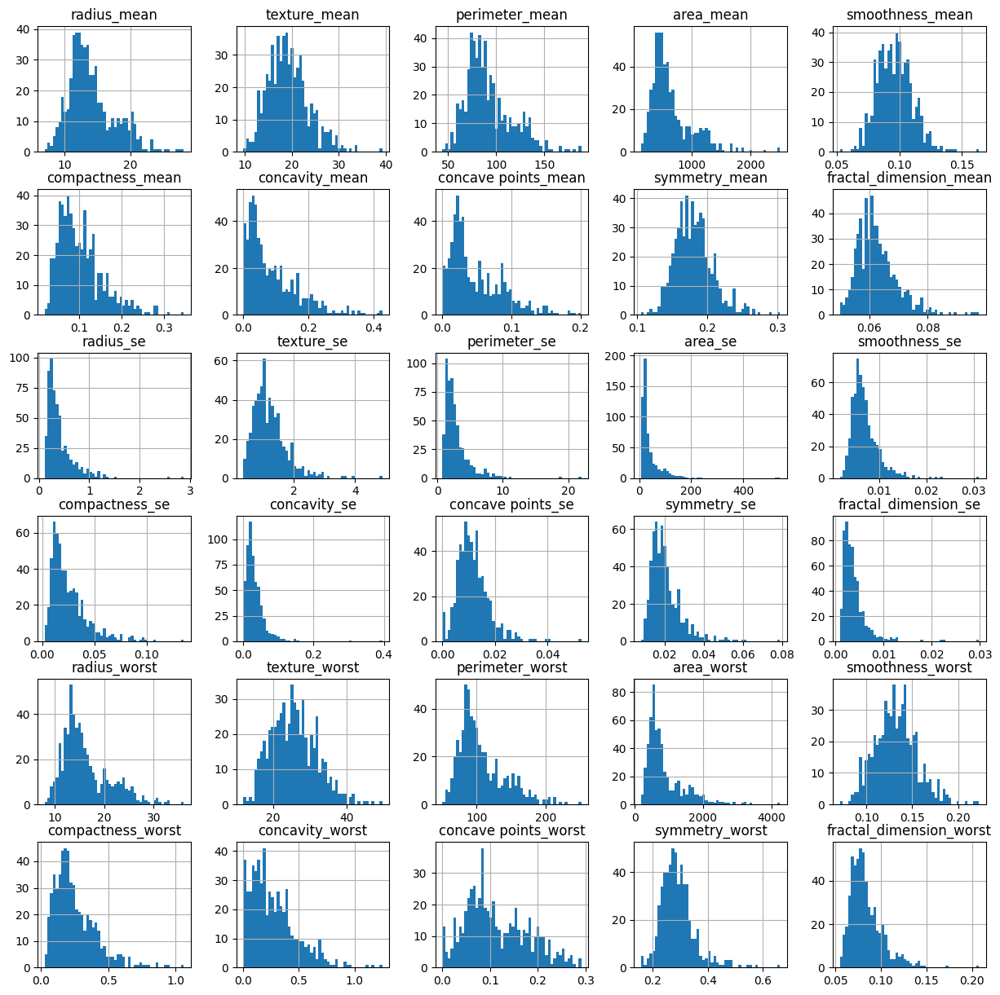

In [ ]:
# Data visualization to create histogram
df.hist(bins=50, figsize=(15, 15))
plt.show()

In [ ]:
# Scatter matrix to check correlation between two attributes
sns.pairplot(df, hue='diagnosis')


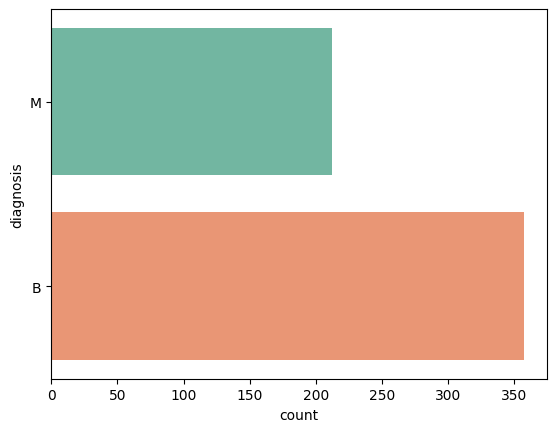

In [ ]:
# Count each label
ax = sns.countplot(y='diagnosis', data=df, palette='Set2')


In [ ]:
# # Finding correlation
# fig, ax = plt.subplots(figsize=(12, 10))
# sns.heatmap(df.corr(), ax=ax)

# print(df.groupby('diagnosis').size())
# sns.countplot(df['diagnosis'],label="Count")
# plt.show()

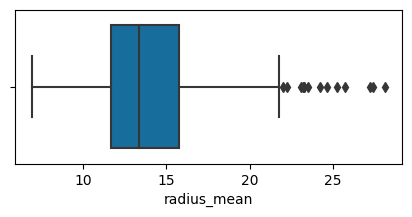

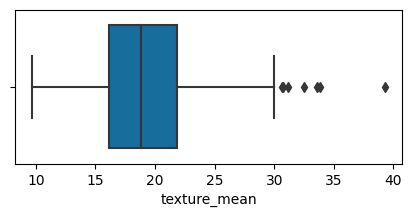

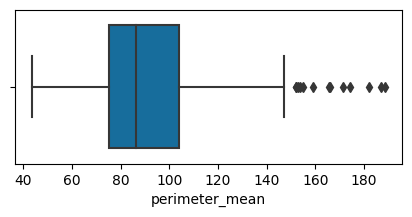

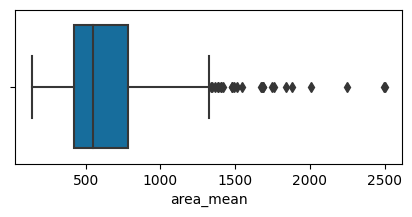

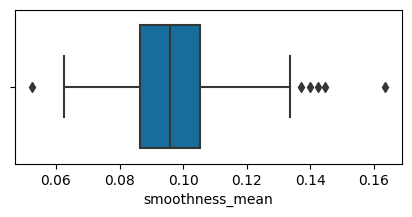

...

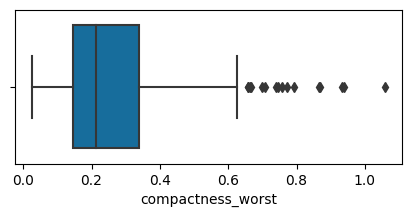

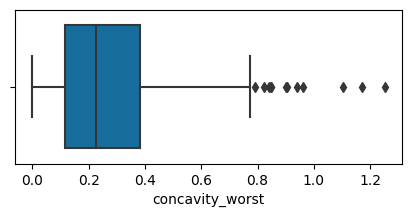

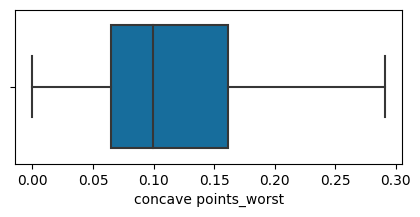

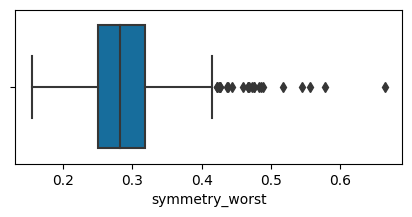

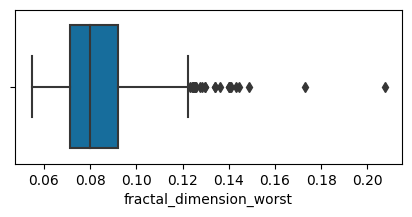

In [ ]:
# box plot to check outlier in each category
def boxPlot(dff):
    d = dff.drop(columns=['diagnosis'])
    for column in d:
        plt.figure(figsize=(5, 2))
        sns.boxplot(x=column, data=d, palette="colorblind")

boxPlot(df)

In [ ]:
# Quartile range

Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)
inter_quartile_range = Q3 - Q1


In [ ]:
# quartiles and interquartile range

df_out = df[~((df < (Q1 - (1.5 * inter_quartile_range))) | (df > (Q3 + (1.5 * inter_quartile_range)))).any(axis=1)]
df.shape, df_out.shape


((569, 31), (398, 31))

In [ ]:
# Separate labels and features
X = df_out.drop(columns=['diagnosis'])
y = df_out['diagnosis']


In [ ]:
# Convert the M to 1 and B to 0
label = LabelEncoder()
y = label.fit_transform(y)
y[:20]

array([0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1])

In [ ]:
# Spilt the train and test data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)
# we used 30% test data
# check the size before beginning
X_train.shape, X_test.shape, y_train.shape, y_test.shape


((278, 30), (120, 30), (278,), (120,))

In [ ]:
# cross validation function
def tn(y_true, y_pred):
    return confusion_matrix(y_true, y_pred)[0, 0]


In [ ]:
def fp(y_true, y_pred):
    return confusion_matrix(y_true, y_pred)[0, 1]


In [ ]:
def fn(y_true, y_pred):
    return confusion_matrix(y_true, y_pred)[1, 0]

In [ ]:
def tp(y_true, y_pred):
    return confusion_matrix(y_true, y_pred)[1, 1]



In [ ]:
def acc(y_true, y_pred):
    return accuracy(y_true, y_pred)


In [ ]:
# custom accuracy
def accuracy(y_true, y_pred):
    cnf_matrix = confusion_matrix(y_true, y_pred)
    N = sum(map(sum, cnf_matrix))
    tp = cnf_matrix[1, 1]
    tn = cnf_matrix[0, 0]
    return round((tp + tn) / N, 2)


In [ ]:
# cross validation purpose
scoring = {'accuracy': make_scorer(metrics.accuracy_score), 'prec': 'precision'}
scoring = {'tp': make_scorer(tp), 'tn': make_scorer(tn),
           'fp': make_scorer(fp), 'fn': make_scorer(fn),
           'acc': make_scorer(acc)}

In [ ]:
def print_result(result):
    print("True Positive: ", result['test_tp'])
    print("True Negative: ", result['test_tn'])
    print("False Negative: ", result['test_fn'])
    print("False Positive: ", result['test_fp'])
    print("Accuracy: ", result['test_acc'])


In [ ]:
# acc list and roc list stores the output of each model
acc = []
roc = []


Naive Bayes

In [ ]:
# Naive Bayes
model_1 = GaussianNB()
model_1.fit(X_train, y_train)
y_pred = model_1.predict(X_test)
y_pred_train = model_1.predict(X_train)

ac = accuracy_score(y_test, y_pred)
acc.append(ac)
ac_train = accuracy_score(y_train, y_pred_train)
rc = roc_auc_score(y_test, y_pred)
roc.append(rc)
print("Naive Bayes : ")
print("Training Set Accuracy : ", ac_train)
print("Test Set Accuracy {0} ROC {1}".format(ac, rc))


Naive Bayes : 
Training Set Accuracy :  0.9424460431654677
Test Set Accuracy 0.9666666666666667 ROC 0.9673295454545454


In [ ]:
# cross validation
result = cross_validate(model_1, X_train, y_train, scoring=scoring, cv=10)
print_result(result)

True Positive:  [5 6 6 6 5 7 7 7 4 6]
True Negative:  [22 19 17 19 21 21 21 21 20 21]
False Negative:  [1 0 1 1 2 0 0 0 2 0]
False Positive:  [0 3 4 2 0 0 0 0 1 0]
Accuracy:  [0.96 0.89 0.82 0.89 0.93 1.   1.   1.   0.89 1.  ]


Logistic Regression

In [ ]:
# Logistic Regression
LR = LogisticRegression()
LR.fit(X_train, y_train)
LR.score(X_train, y_train)
y_pred = LR.predict(X_test)
y_pred_train = model.predict(X_train)


NameError: ignored

In [ ]:
# find accuracy
ac = accuracy_score(y_test, y_pred)
acc.append(ac)
ac_train = accuracy_score(y_train, y_pred_train)

In [ ]:
# Code for ROC_AUC curve
rc = roc_auc_score(y_test, y_pred)
roc.append(rc)
print("****************************************************")
print("Logistic Regression : ")
print("Training Set Accuracy : ", ac_train)
print("Test Set Accuracy {0} ROC {1}".format(ac, rc))


In [ ]:
# cross validation shows how accurate our model is
result = cross_validate(LR, X_train, y_train, scoring=scoring, cv=10)
print_result(result)

Support Vector Machine

In [ ]:
# Support Vector Machine
model_3 = SVC(gamma='auto', kernel='linear')
model_3.fit(X_train, y_train)
y_pred = model_3.predict(X_test)
y_pred_train = model_3.predict(X_train)

ac = accuracy_score(y_test, y_pred)
acc.append(ac)
ac_train = accuracy_score(y_train, y_pred_train)
rc = roc_auc_score(y_test, y_pred)
roc.append(rc)
print("****************************************************")
print("Support Vector Machine : ")
print("Training Set Accuracy : ", ac_train)
print("Test Set Accuracy {0} ROC {1}".format(ac, rc))


In [ ]:
# cross validation
result = cross_validate(model_3, X_train, y_train, scoring=scoring, cv=10)
print_result(result)


K-Nearest Neighbour

In [ ]:
# KNN
model_4 = KNeighborsClassifier(n_neighbors=9, n_jobs=-1)
model_4.fit(X_train, y_train)
y_pred = model_4.predict(X_test)
y_pred_train = model_4.predict(X_train)

In [ ]:
# Accuracy
ac = accuracy_score(y_test, y_pred)
acc.append(ac)
ac_train = accuracy_score(y_train, y_pred_train)
rc = roc_auc_score(y_test, y_pred)
roc.append(rc)
print("****************************************************")
print("K-Nearest Neighbors : ")
print("Training Set Accuracy : ", ac_train)
print("Accuracy {0} ROC {1}".format(ac, rc))


Saving the trained model

In [ ]:
import pickle

In [ ]:
filename = 'Cancer_model.sav'
pickle.dump(model_4,open(filename,'wb'))

In [ ]:
# loading the saved model
loaded_model= pickle.load(open('Cancer_model.sav','rb'))

In [ ]:
# cross validation
result = cross_validate(model_4, X_train, y_train, scoring=scoring, cv=10)
print_result(result)


Random Forest Classifier

In [ ]:
# Random Forest
model_5 = RandomForestClassifier(n_estimators=20, max_depth=10)
model_5.fit(X_train, y_train)
y_pred = model_5.predict(X_test)
y_pred_train = model_5.predict(X_train)

Accuracy of Random Forest

In [ ]:
ac = accuracy_score(y_test, y_pred)
acc.append(ac)
ac_train = accuracy_score(y_train, y_pred_train)
rc = roc_auc_score(y_test, y_pred)
roc.append(rc)
print("****************************************************")
print("Random Forest : ")
print("Training Set Accuracy : ", ac_train)
print("Accuracy {0} ROC {1}".format(ac, rc))

In [ ]:
# cross validation
result = cross_validate(model_5, X_train, y_train, scoring=scoring, cv=10)
print_result(result)


Plot the bar graph for accuracy and  roc-auc

In [ ]:
# accuracy score
plt.figure(figsize=(8, 5))
plt.bar(['Logistic Regression', 'SVM', 'KNN', 'Naive Bayes', 'Random Forest'], acc,
        color=['salmon', 'r', 'g', 'b', 'orange'], label='Accuracy')
plt.ylabel('Accuracy Score')
plt.xlabel('Algortihms')


In [ ]:
# roc-auc
plt.figure(figsize=(8, 5))
plt.bar(['Logistic Regression', 'SVM', 'KNN', 'Naive Bayes', 'Random Forest'], roc,
        color=['salmon', 'r', 'g', 'b', 'orange'], label='ROC AUC')
plt.ylabel('ROC AUC')
plt.xlabel('Algortihms')
plt.show()


Accuracy of Model for Cancer Prediction

In [ ]:
print("Random Forest : ")
print("Training Set Accuracy : ", ac_train)